# Space-time partial differential equation: Study of the diffusive equation (implicit methods)

Let's consider now the viscous term in Burger's equation: 

$$\frac{\partial u}{\partial t} = \nu \frac{\partial^2 u}{\partial x^2}, \tag{1}$$

## 1- Apply an explicit method. 

What would be the CFL condition for a viscous term where $\nu$ is either a constant or an array that depends on $x$. We would like to solve equation (1) numerically for $x  [x_0, x_f]$ with $x_0 = −2.6$, $x_f = 2.6$, periodic boundary conditions and with the initial condition:

$$u(x,t=t_0) = A\exp(-(x-x_0)^2/W^2)   \tag{2}$$

with $A=0.3$, $W=0.1$, and $x_0=0$. __Suggestion__: Apply the first derivative upwind and the second downwind. Apply Von Newman analysis. Is it stable? What is the time-step dependence with $\Delta x$? 

How many steps are needed to reach a $t=1.8$ for $nump=128$? And $256$? 

In [1]:
import numpy as np 
import matplotlib.pyplot as plt 
from nm_lib import nm_lib as nm
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
import scipy as sp
from scipy import stats

In [2]:
def initial_u(xx): 
    r"""
    Returns the initial condition u(x,t=0) form Eq.2
    
    Requires
    ----------
    Numpy

    Parameters
    ----------
    xx : `array`
        spatial array. 

    Returns
    ------- 
    u(x,t=0) : `array`
            Initial condition for u(x,t)
        
    """
    W = 0.1
    A = 0.3
    x0 = 0

    return A*np.exp(-(xx-x0)**2/W**2)

To find the CFL condition, we start by rewriting Eq.1 as a discretized equation and set it up as an equation for $u_j^{n+1}$: 

$$\tag{A.1}
    \frac{u^{n+1}_j - u^n_j}{\Delta t} = \nu \left( \frac{u_{j+1}^n - 2u_j^n + u_{j-1}^n}{\Delta x^2}  \right)
$$

$$\tag{A.2}
\implies u^{n+1} = u^n + \nu \left( \frac{u_{j+1}^n - 2u_j^n + u_{j-1}^n}{\Delta x^2}  \right)\Delta t
$$

Using the solution form from von Neumann analysis, $u_j^n = \xi^n e^{ikj\Delta x}$, we can rewrite A.2 as: 

$$\tag{A.3}
\xi^{n+1} e^{ikj\Delta x} = \xi^n e^{ikj\Delta x} + \frac{\nu \Delta t}{\Delta x^2} \left( \xi^n e^{ik(j+1)\Delta x} - 2\xi^n e^{ikj\Delta x} + \xi^n e^{ik(j-1)\Delta x}  \right)
$$


We then cancel out all the $e^{ikj\Delta x}$ terms: 

$$\tag{A.4}
    \xi^{n+1} = \xi^n + \frac{\nu \Delta t}{\Delta x^2}\left( \xi^n e^{ik\Delta x} - 2\xi^n  + \xi^n e^{ik\Delta x}  \right)
$$

$$\tag{A.5}
\implies \xi = 1 + \frac{\nu \Delta t}{\Delta x^2}\left(e^{ik\Delta x} - 2 +  e^{ik\Delta x}  \right)
$$


Using *Euler's formula*, we rewrite the exponentials: 

$$\tag{A.6}
\xi = 1 - 2\frac{\nu \Delta t}{\Delta x^2} + \frac{\nu \Delta t}{\Delta x^2} \left(  \cos(k \Delta x) + i\sin(k\Delta x) + \cos(k\Delta x) - i\sin(k\Delta x) \right)
$$

which can be simplified to: 

$$\tag{A.7}
\xi = 1 -4\frac{\nu \Delta t}{\Delta x^2}\sin^2(k\Delta x/2)
$$


For the solution to be stable, we set the condition: $|\xi|^2 \leq 1$. Applying this to the $\xi$ from A.7 we get

$$\tag{A.8}
1 - 2\frac{4\nu \Delta t}{\Delta x^2} \sin^2(k\Delta x/2) + \frac{16 \nu^2 \Delta t^2}{\Delta x^4}\sin^4(k\Delta x/2) \leq 1 
$$

$$\tag{A.9}
\implies \frac{16 \nu^2 \Delta t^2}{\Delta x^4}\sin^4(k\Delta x/2) \leq frac{8\nu \Delta t}{\Delta x^2} \sin^2(k\Delta x/2)
$$

$$\tag{A.10}
\implies \frac{2\nu \Delta t}{\Delta x^2} \sin^2(k\Delta x/2) \leq 1
$$

$$\tag{A.11}
\implies \frac{\nu \Delta t}{\Delta x^2} \sin^2(k\Delta x/2) \leq \frac{1}{2}
$$

$$\tag{A.12}
\implies \Delta t \leq \frac{\Delta x^2}{2\nu},
$$

where we have used that $\sin^2 \leq 1$. 

When the condition in A.12 is fulfilled, the solution is stable. We also here see the dependence on $\Delta x$ in $\Delta t$. 

In the cell below we use this CFL condition to compute the $\Delta t$ and the number of steps, `numps`, needed for the cases of `nint = 128` and `nint = 256`.

In [3]:
nint = 128
nump = nint+1 

nint2 = 256
nump2 = nint2+1

x0 = -2.6
xf = 2.6

x = np.linspace(x0,xf,nump)
x2 = np.linspace(x0,xf,nump2)


dx = x[1]-x[0]
dx2 = x2[1] - x2[0]

t = 0
t2 = 0
steps = 0
steps2 = 0

dt = dx**2/2
dt2 = dx2**2/2

print("dt with nint = 128: ", dt)
print("dt with nint = 256: ", dt2, "\n")

while t <= 1.8: 
    t += dt 
    steps += 1
    

while t2 <= 1.8: 
    t2 += dt2
    steps2 += 1

print("Number of steps needed for nint = 128: ", steps)
print("Number of steps needed for nint = 256: ", steps2, "\n")


dt with nint = 128:  0.0008251953124999964
dt with nint = 256:  0.0002062988281250036 

Number of steps needed for nint = 128:  2182
Number of steps needed for nint = 256:  8726 



From the result above, we see that when doubling the number of intervals, `nint`, we increase the number of steps `numps` by a factor of 4. 

In [4]:
def deriv2(xx,hh): 
    r"""
    Returns the second order derivative of u(x) using first upwind and then downwind
    
    Requires
    ----------
    Numpy

    Parameters
    ----------
    x : `array`
        spatial array. 

    hh : `hh`
        u(x)

    Returns
    ------- 
    d^2u/dx^2 : `array`
            Second order derivative of u(x,t)
        
    """

    dx = xx[1] - xx[0]
    u_deriv = (np.roll(hh,-1) - 2*hh + np.roll(hh,1))/dx**2

    return u_deriv

In [5]:
def cfl_ddx2(nu,xx):

    r"""
    Computes the dt_fact
    
    Requires
    ----------
    Numpy

    Parameters
    ----------
    xx : `array`
        spatial array. 

    nu : `float` or array
        viscosity term

    Returns
    ------- 
    `float`
        min(dx/|a|)
        
    """

    dx = xx[1] - xx[0]
    return np.min(dx**2/(2*np.abs(nu)))

In [6]:
def step(xx, hh, a, cfl_cut = 0.98, 
                    ddx = lambda x,y: nm.deriv_dnw(x, y, roll=True), **kwargs): 
    
    r"""
    Right hand side of Burger's eq.   

    Requires
    --------
        cfl_ddx2

    Parameters
    ----------   
    xx : `array`
        Spatial axis. 
    hh : `array`
        Function that depends on xx.
    cfl_cut : `array`
        Constant value to limit dt from cfl_adv_burger. 
        By default 0.98
    ddx : `lambda function` 
        Allows to select the type of spatial derivative.
        By default lambda x,y: deriv_dnw(x, y)


    Returns
    -------
    dt : `array`
        time interval
    rhs : `array`
        right hand side of Burger's equation.
    """ 
    
    dt = cfl_cut*cfl_ddx2(a,xx)
    rhs = a*ddx(xx,hh)
    return dt, rhs

In [7]:
def evolve(xx, hh, nt, a, cfl_cut = 0.98, 
        ddx = lambda x,y: nm.deriv_dnw(x, y), 
        bnd_type='wrap', bnd_limits=[1,1], **kwargs):
    
    r"""
    Advance nt time-steps in time the burger eq for a being a a fix constant or array.

    Requires
    --------
    step_adv_burgers

    Parameters
    ----------
    xx : `array`
        Spatial axis. 
    hh : `array`
        Function that depends on xx.
    nt : `int`
        Number of iterations
    a : `float` or `array`
        Either constant, or array which multiply the right hand side of the Burger's eq.
    cfl_cut : `float`
        Constant value to limit dt from cfl_adv_burger. 
        By default 0.98
    ddx : `lambda function` 
        Allows to change the space derivative function. 
        By default lambda x,y: deriv_dnw(x, y)
    bnd_type : `string` 
        It allows to select the type of boundaries. 
        By default 'wrap'
    bnd_limits : `list(int)`
        Array of two integer elements. The number of pixels that
        will need to be updated with the boundary information. 
        By default [0,1]

    Returns
    -------
    t : `array`
        Time 1D array
    un : `array`
        Spatial and time evolution of u^n_j for n = (0,nt), and where j represents
        all the elements of the domain. 
    """

    t = np.zeros(nt)
    un = np.zeros((len(xx), nt))

    un[:,0] = hh
    d = len(un)

    for i in range(nt-1):


        dt, rhs = step(xx, hh, a, cfl_cut = cfl_cut ,ddx = ddx) 
        un[:,i+1] = hh + rhs*dt
        t[i+1] = t[i]+dt
        un[:,i+1] = np.pad(un[bnd_limits[0]:d- bnd_limits[1],i+1], bnd_limits, bnd_type)
        hh = un[:,i+1]
        
    return t, un

In [8]:
nump = 128

x = np.linspace(x0,xf,nump)

nt = 10000

u0 = initial_u(x)
t, un = evolve(x, u0, nt , 1  ,ddx = deriv2, bnd_limits=[1,1])

In [9]:
plt.ioff()

fig, axes = plt.subplots(nrows=1, ncols=1, figsize=(10, 5))

def init(): 
    axes.plot(x,un[:,0])

def animate(i):
 
    axes.clear()
    axes.plot(x,un[:,::100][:,i], label="upwind-downwind")
    axes.set_title('t=%.2f'%t[::100][i])
    axes.set_xlabel("x")
    axes.set_ylabel("u_i")
    axes.grid()
    axes.legend()
    
anim = FuncAnimation(fig, animate, interval=50, frames=len(t[::100]), init_func=init)
HTML(anim.to_jshtml())

In [10]:
plt.close()

When animating the solution for the viscous term in the Burger's equation we see it is diffusive and the amplitude is decreasing with time. 

<span style="color:green">JMS </span>.

<span style="color:blue">Good! </span>.

## Choose one of the following options: 

## 2- Implicit methods.

In the [wiki](https://github.com/AST-Course/AST5110/wiki/Implicit-methods), we describe some implicit or semi-explicit methods that allow relaxing the CFL constraint on diffusive terms. Consider Newton-Rapson method and repeat the previous numerical experiment. For this, you will need to implement the following   


$F_j = u^{n+1}_j - u^n_j - \nu \, (u^{n+1}_{j+1} - 2u^{n+1}_{j}+u^{n+1}_{j-1})\frac{\Delta t}{\Delta x^2}$

in `NR_f` and `step_diff_burgers` functions in `nm_lib`. 

And the Jacobian can be easily built. 

$J(j,k) = F_j'(u^{n+1}_k)$

fill in the `jacobian` function in `nm_lib`. Note that this matrix is linear with $u$. 

Test the model with [wiki](https://github.com/AST-Course/AST5110/wiki/Self-similar-solution-for-parabolic-eq) self-similar solutions. How long it takes each time step compared to the Lax-method? Use `time.time` library. Do it for nump=256, nt=30 and dt = 0.1. In order to test the simulation, use `curve_fit` from `scipy.optimize`. 

__hint__ consider to use a good initial guess (`p0`) in and `bnd_limits` to facilitate the fitting wiht `curve_fit`. What happens to the solution when increasing dt? How much can be improved in limiting the tolerance?

----------------------------------------------

Let's consider a non-linear function where $\nu$ depends on $u$. To keep it simple, solve the following: 

$\frac{\partial u}{\partial t} = u \frac{\partial^2 u}{\partial x^2}$

where $\nu_0$ is a constant and the same initial conditions as the previous exercise (fill in `Newton_Raphson_u`, `jacobian_u` and `NR_f_u`. Consider an error limit of $10^{-4}$ and compare the previous exercise (with the same error limit). How many iterations needs now the method to converge to the right solution? Why? Increase `ncount` to 1000. 

## 3- Semi-explicit methods. 

__a)__ Super-time-stepping (STS) schemes work for parabolic terms. STS is an API method that performs a subset of "unstable" intermediate steps, but the sum of all the steps is stable. Visualize how `taui_sts` varies with $nu$ and $niter$. Compare the solution with the analytical one for the final and intermediate STS steps. For the full STS steps, how improves the solution with $nu$? and $niter$? Is there a relation between the error and these two parameters, $nu$, and $niter$? For which $niter$ and $nu$ the method provides larger steps than an ordinary explicit. For this exercise, fill in `evol_sts`, and `taui_sts`. 

In [11]:
nt = 2000
t_sts_0, un_sts_0 = nm.evol_sts(x, u0, nt , 1 , ddx = deriv2, bnd_limits=[1,1], nu=0.5, n_sts=10)
t, un = evolve(x, u0, nt , 1  ,ddx = deriv2, bnd_limits=[1,1])

In [12]:
plt.ioff()
N = 10

fig, axes = plt.subplots(nrows=1, ncols=1, figsize=(10, 5))

def init(): 
    axes.plot(x,un_sts_0[:,0])

def animate(i):
 
    axes.clear()
    axes.plot(x,un_sts_0[:,::N][:,i])
    axes.set_title('Super Time Stepping, t=%.2f'%t_sts_0[::N][i])
    axes.set_xlabel("x")
    axes.set_ylabel("u_i")
    axes.grid()
    
anim = FuncAnimation(fig, animate, interval=50, frames=len(t_sts_0[::N]), init_func=init)
HTML(anim.to_jshtml())

In [13]:
plt.close()

Similarly to the solution using the double derivative with upwind and downwind, our STS solution is diffusive with a decreasing amplitude. To get a better comparison, we animate the two solutions together.

In [14]:
same = t_sts_0.reshape(len(t_sts_0),1) - t
same2 = np.where(np.abs(same)<0.005)

In [15]:

M=100
plt.ioff()

fig, axes = plt.subplots(nrows=1, ncols=1, figsize=(10, 5))

def init(): 
    axes.plot(x,un[:,0])
    axes.plot(x,un_sts_0[:,0])

def animate(i):

    axes.clear()
    axes.plot(x,un[:,same2[1]][:,::M][:,i], label="upwind-downwind")
    axes.plot(x,un_sts_0[:,same2[0]][:,::M][:,i], label="STS")
    axes.set_title('t_sts=%.2f'%t_sts_0[same2[0]][::M][i])
    axes.legend()
    axes.set_xlabel("x")
    axes.set_ylabel("u_i")
    axes.grid()
    
anim = FuncAnimation(fig, animate, interval=50, frames=len(t_sts_0[same2[0]][::M]), init_func=init)
HTML(anim.to_jshtml())

In [16]:
plt.close()

The initial curve in both the upwind-downwind scheme and the STS scheme seem to be the same. Evolving one step in time we see the amplitude of the STS scheme being higher than for the upwind-downwind. After another step, it seems as if the upwind-downwind scheme is catching up to the STS scheme. All in all, the two solutions seem to evolve quite similarly. 

We now focus on the intermediate time steps, $\tau_i$, and see how they behave when we change $\nu$ and `niter`, keeping one of them constant while changing the other.

In [17]:
tau_01_10 = np.zeros(10)
tau_03_10 = np.zeros(10)
tau_05_10 = np.zeros(10)
tau_09_10 = np.zeros(10)

tau_03_01 = np.zeros(1)
tau_03_05 = np.zeros(5)
tau_03_15 = np.zeros(15)
tau_03_50 = np.zeros(50)


iiter = np.arange(1,11)


for i in range(10): 
    tau_01_10[i] = nm.taui_sts(0.1, 10, iiter[i])
    tau_03_10[i] = nm.taui_sts(0.3, 10, iiter[i])
    tau_05_10[i] = nm.taui_sts(0.5, 10, iiter[i])
    tau_09_10[i] = nm.taui_sts(0.9, 10, iiter[i])

tau_03_01 = nm.taui_sts(0.3, 1, 1)
tau_03_05 = nm.taui_sts(0.3, 5, np.arange(1,6))
tau_03_15 = nm.taui_sts(0.3, 15, np.arange(1,16))
tau_03_50 = nm.taui_sts(0.3, 50, np.arange(1,51))



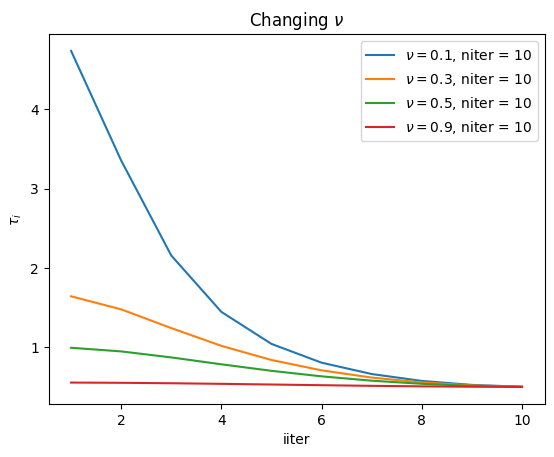

In [18]:
plt.plot(iiter, tau_01_10, label=r"$\nu = 0.1$, niter = 10")
plt.plot(iiter, tau_03_10, label=r"$\nu = 0.3$, niter = 10")
plt.plot(iiter, tau_05_10, label=r"$\nu = 0.5$, niter = 10")
plt.plot(iiter, tau_09_10, label=r"$\nu = 0.9$, niter = 10")
plt.xlabel("iiter")
plt.ylabel(r"$\tau_i$")
plt.title(r"Changing $\nu$")
plt.legend()
plt.show()

In this plot, we let `niter` be constant while varying $\nu$, letting it increase from 0.1 to 0.9. For smaller $\nu$, we notice the intermediate time steps $\tau_i$ starts at a higher value than when increasing $\nu$. As `iiter` increases, the intermediate time steps decreases and in all the different cases it appears to converge towards a constant value. 

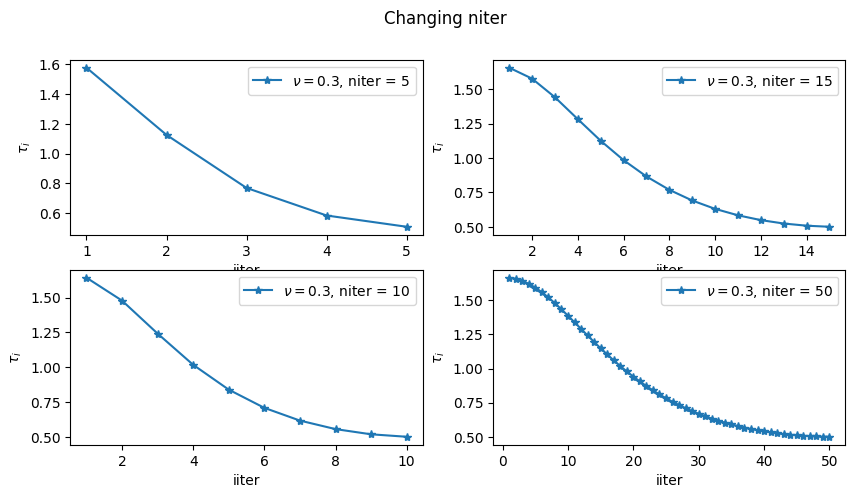

In [19]:
fig, axes = plt.subplots(nrows=2, ncols=2,figsize=(10, 5))

plt.suptitle(r"Changing niter")

axes[0,0].plot(np.arange(1,6), tau_03_05, "-*",label=r"$\nu = 0.3$, niter = 5")
axes[1,0].plot(np.arange(1,11), tau_03_10,"-*" ,label=r"$\nu = 0.3$, niter = 10")
axes[0,1].plot(np.arange(1,16), tau_03_15, "-*", label=r"$\nu = 0.3$, niter = 15")         
axes[1,1].plot(np.arange(1,51), tau_03_50, "-*" ,label=r"$\nu = 0.3$, niter = 50")

axes[0,0].set_xlabel("iiter")
axes[0,0].set_ylabel(r"$\tau_i$")
axes[1,0].set_xlabel("iiter")
axes[1,0].set_ylabel(r"$\tau_i$")
axes[0,1].set_xlabel("iiter")
axes[0,1].set_ylabel(r"$\tau_i$")
axes[1,1].set_xlabel("iiter")
axes[1,1].set_ylabel(r"$\tau_i$")

axes[0,0].legend()
axes[0,1].legend()
axes[1,0].legend()
axes[1,1].legend()


plt.show()

In the subplot above, we show how the intermediate time steps evolve for each `iiter` when changing `niter`. Increasing `niter` makes the curve smoother due to the smaller steps. Due to the small value of `niter`, we do not see the same shape for `niter = 5` as for `niter = 50`.

<span style="color:green"> JMS.  </span>.

<span style="color:blue"> Good job!  </span>.


In [20]:
nump = 128

x = np.linspace(x0,xf,nump)
dx = x[1]-x[0]
cfl_cut = 0.98
a = 1

delta_cfl = cfl_cut*np.min(dx**2/(2*np.abs(a)))

nu = 0.01

print("Explicit method ", delta_cfl)
print(" ")

tau_03_01 = nm.taui_sts(nu, 1, 1)
tau_03_05 = nm.taui_sts(nu, 5, np.arange(1,6))
tau_03_15 = nm.taui_sts(nu, 15, np.arange(1,16))
tau_03_50 = nm.taui_sts(nu, 50, np.arange(1,51))

print("tau w/ niter = 1: ", delta_cfl*np.sum(tau_03_01))
print("tau w/ niter = 5: ", delta_cfl*np.sum(tau_03_05))
print("tau w/ niter = 10: ", delta_cfl*np.sum(tau_03_10))
print("tau w/ niter = 50: ", delta_cfl*np.sum(tau_03_50))

Explicit method  0.0008214768429536936
 
tau w/ niter = 1:  0.0008133434088650432
tau w/ niter = 5:  0.015669648955161118
tau w/ niter = 10:  0.00749902328892189
tau w/ niter = 50:  0.2053692099467469


In [21]:
print("tau w/ nu = 0.1: ", delta_cfl*np.sum(tau_01_10))
print("tau w/ nu = 0.3: ", delta_cfl*np.sum(tau_03_10))
print("tau w/ nu = 0.5: ", delta_cfl*np.sum(tau_05_10))
print("tau w/ nu = 0.9: ", delta_cfl*np.sum(tau_09_10))

tau w/ nu = 0.1:  0.01298863610842336
tau w/ nu = 0.3:  0.00749902328892189
tau w/ nu = 0.5:  0.005808718462402727
tau w/ nu = 0.9:  0.004329563114696856


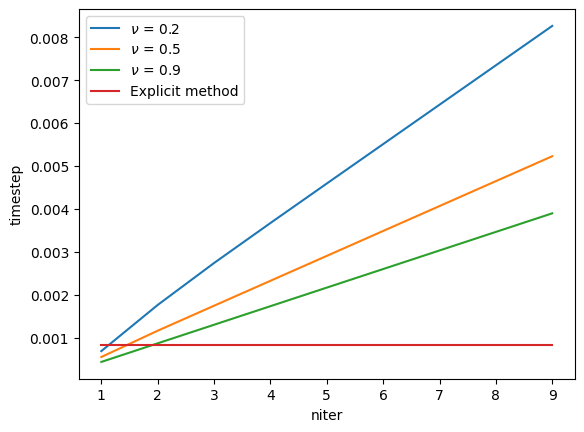

In [22]:
tau_sum = np.zeros(9)
tau_sum2 = np.zeros(9)
tau_sum3 = np.zeros(9)
for i in range(1,10): 
    tau_02_i = nm.taui_sts(0.2, i, np.arange(1,i+1))
    tau_05_i = nm.taui_sts(0.5, i, np.arange(1,i+1))
    tau_09_i = nm.taui_sts(0.9, i, np.arange(1,i+1))

    tau_sum[i-1] = delta_cfl*np.sum(tau_02_i)
    tau_sum2[i-1] = delta_cfl*np.sum(tau_05_i)
    tau_sum3[i-1] = delta_cfl*np.sum(tau_09_i)


plt.plot(np.arange(1,10),tau_sum, label=r"$\nu$ = 0.2")
plt.plot(np.arange(1,10),tau_sum2, label=r"$\nu$ = 0.5")
plt.plot(np.arange(1,10),tau_sum3, label=r"$\nu$ = 0.9")
plt.plot([1,9], [delta_cfl,delta_cfl], label="Explicit method")
plt.xlabel("niter")
plt.ylabel("timestep")
plt.legend()
plt.show()

First we print out the full time steps after `niter`, keeping $\nu = 1$, for four different values of `niter`. For `niter` = 1, we get a timestep that is smaller than the explicit method by a factor of 2, but increasing the `niter` gives us increasingly larger timesteps. Keeping `niter` = 10, and letting $\nu$ vary, we notice that the timesteps are larger for smaller values of $\nu$ and decreases when we increase $\nu$. In the plot above, we plot three curves, each with a different value for $\nu$, where we show how the timesteps are increasing when we increase `niter`. We also plot the explicit timestep as a constant curve. We notice again that for the first `niter`, the timesteps are lower than the explicit method. When we increase $\nu$, we also shift where the curves intersect with the explicit method. When $\nu$ is closer to $1$, the intersection is happening closer to `niter` = 2. 

#### Fitting the STS solution with a Gaussian curve.

To compare our STS solution to an analytical solution, we use a Gaussian function and fit it to our STS curve. This way, we can compare the width and amplitude of the Gaussian fit to what we expect from analytical models.

In [23]:
from scipy.optimize import curve_fit
nt = 2000

t_sts, un_sts = nm.evol_sts(x, u0, nt , 1 , ddx = deriv2, bnd_limits=[1,1], nu=0.1, n_sts=10)

<span style="color:green">JMS </span>.

<span style="color:red">I get an error here </span>.

In [24]:
def Gaussian(xx, A, mu, sigma, C): 
    r"""
    Gaussian function

    Requires
    --------
    step_adv_burgers

    Parameters
    ----------
    xx : `array`
        Spatial axis. 
    A : `float`
        Amplitude of Gaussian function
    mu : `float`
        expectation value 
    sigma : `float`
            standard deviation
    C : `integer` or `float`
        constant 


    Returns
    -------
    Gaussian : `array`
            Gaussian function
    """

    return A*np.exp(-0.5*(xx-mu)**2/sigma**2) + C


Here we do the fitting of the curve, using `curve_fit`. 

In [25]:
M = 20

sigma = np.zeros(M)
Amp = np.zeros(M)
C = np.zeros(M)
mu = np.zeros(M)

for i in range(M): 
    popt, pcov = curve_fit(Gaussian, x, un_sts[:,i])
    
    Amp[i] = popt[0]
    mu[i] = popt[1]
    sigma[i] = popt[2]
    C[i] = popt[3]
    

We find the coefficient to use in the analytical solution for the amplitude, using the analytical relation from the wiki: $u\propto t^{-1/2}$ and the amplitude from the Gaussian fitting.

In [26]:
max_A_t1 = Amp[10]/t_sts[10]**(-1/2)


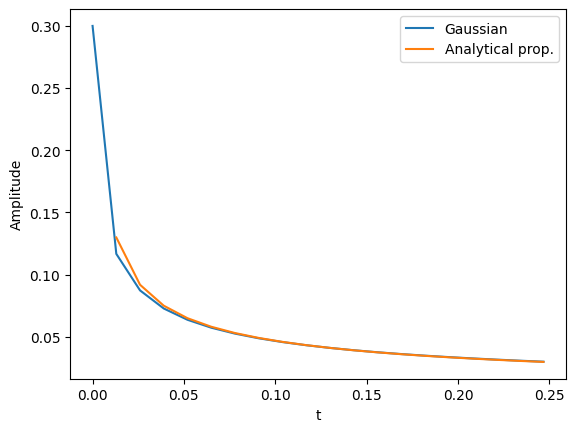

In [27]:
plt.plot(t_sts[:M], Amp[:], label="Gaussian")
plt.plot(t_sts[1:M], max_A_t1*t_sts[1:M]**(-1/2), label="Analytical prop.")
plt.legend()
plt.xlabel("t")
plt.ylabel("Amplitude")
plt.show()

In [28]:
plt.close()

From the plot above, we see that the Gaussian fitting of the STS solution seem to fit well with the analytical solution, at least after the first time steps.

The analytical proportionality for the width of `u` is: $R \propto t^{1/2}$. Using the $\sigma$ from the Gaussian fitting, we find the coefficient `c_sig` that we need in order to compare the analytical solution to the sigma from our Gaussian fit. We do this again for a certain time index and plot both the analytical proportionality along with the Gaussian fitting.

In [29]:
c_sig = sigma[5]/t_sts[5]**0.5

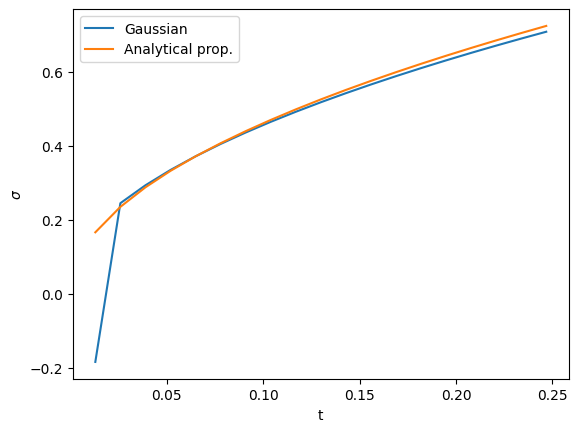

In [30]:
plt.plot(t_sts[1:M], sigma[1:], label="Gaussian")
plt.plot(t_sts[1:M], c_sig*t_sts[1:M]**0.5, label="Analytical prop.")
plt.legend()
plt.xlabel("t")
plt.ylabel(r"$\sigma$")
plt.show()

In [31]:
plt.close()

As we saw for the amplitude of the Gaussian fitting, the width $\sigma$ of our Gaussian fitting seem to be quite similar to the analytical solutions. 

To compare the analytical solution to the STS solution, we animate them together below for the similar times. We do this first using the full time steps, before animating the STS solution using the intermediate time steps.

In [32]:
plt.ioff()

fig, axes = plt.subplots(nrows=1, ncols=1, figsize=(10, 5))

def init(): 
    axes.plot(x, Gaussian(x, max_A_t1*t_sts[0]**(-1/2),0 , c_sig*t_sts[0]**0.5, 0))
    axes.plot(x,un_sts[:,0])

def animate(i):
 
    axes.clear()
    axes.plot(x,un_sts[:,:M][:,i], label="STS")
    axes.plot(x, Gaussian(x, max_A_t1*t_sts[i]**(-1/2), 0 , c_sig*t_sts[i]**0.5, 0), label="Analytical")
    axes.set_title('t=%.2f'%t_sts[i])
    axes.grid()
    axes.set_xlabel("x")
    axes.set_ylabel("u_i")
    axes.legend()
    
anim = FuncAnimation(fig, animate, interval=50, frames=len(t_sts[:M]), init_func=init)
HTML(anim.to_jshtml())

C:\Users\eier\AppData\Local\Temp\ipykernel_15916\33874323.py:6: RuntimeWarning: divide by zero encountered in double_scalars
  axes.plot(x, Gaussian(x, max_A_t1*t_sts[0]**(-1/2),0 , c_sig*t_sts[0]**0.5, 0))
C:\Users\eier\AppData\Local\Temp\ipykernel_15916\2013607141.py:29: RuntimeWarning: divide by zero encountered in divide
  return A*np.exp(-0.5*(xx-mu)**2/sigma**2) + C
C:\Users\eier\AppData\Local\Temp\ipykernel_15916\2013607141.py:29: RuntimeWarning: invalid value encountered in multiply
  return A*np.exp(-0.5*(xx-mu)**2/sigma**2) + C
C:\Users\eier\AppData\Local\Temp\ipykernel_15916\33874323.py:13: RuntimeWarning: divide by zero encountered in double_scalars
  axes.plot(x, Gaussian(x, max_A_t1*t_sts[i]**(-1/2), 0 , c_sig*t_sts[i]**0.5, 0), label="Analytical")
C:\Users\eier\AppData\Local\Temp\ipykernel_15916\2013607141.py:29: RuntimeWarning: divide by zero encountered in divide
  return A*np.exp(-0.5*(xx-mu)**2/sigma**2) + C
C:\Users\eier\AppData\Local\Temp\ipykernel_15916\2013607141

In the animation above, we compare the STS solutions using the full time steps, and the analytical solutions based on the proportionalities from the wiki and the Gaussian fitting. Here, the amplitudes are significantly different for the first time steps, which makes sense when we look at the amplitude plot above. In the amplitude plot, the amplitudes are not matching well in the beginning, but the solutions seem to follow the analytical solution better as we evolve in time. This is also the case in this animation, as the STS solution is approaching the Gaussian curve. 

In [33]:
plt.close()

In [34]:
n_sts = 20
nu = 0.01

cfl_cut = 0.98
a = 1
ddx = deriv2

t = np.zeros(nt)
un = np.zeros((len(x), nt))
tmp_t = np.zeros(n_sts+1)

hh = u0

un[:,0] = hh
d = len(un)

dx = x[1] - x[0]
delta_cfl = cfl_cut*np.min(dx**2/(2*np.abs(a)))

    
tmp_u = np.zeros((len(x), n_sts+1))
for i in range(1): 

    tmp_u[:,0] = un[:,i]

    for j in range(1,n_sts+1): 

        rhs = nm.step_diff_burgers(x, hh, a, ddx)
        tmp_u[:,j] = hh + rhs*nm.taui_sts(nu, n_sts, j)*delta_cfl
        tmp_u[:,j] = np.pad(tmp_u[1:-1,j],[1,1],"wrap")
        tmp_t[j] = tmp_t[j-1]+nm.taui_sts(nu, n_sts, j)*delta_cfl
        hh = tmp_u[:,j]

<span style="color:green">JMS </span>.

<span style="color:red">Same error as the above </span>.

In [35]:
M = 10
plt.ioff()

fig, axes = plt.subplots(nrows=1, ncols=1, figsize=(10, 5))

def init(): 
    #axes.plot(x, Gaussian(x, max_A_t1*tmp_t[0]**(-1/2) ,0, c_sig*tmp_t[i]**0.5, 0))
    axes.plot(x,tmp_u[:,0])

def animate(i):
 
    axes.clear()
    axes.plot(x,tmp_u[:,:M][:,i], label="STS int steps")
    #axes.plot(x, Gaussian(x, max_A_t1*tmp_t[i]**(-1/2), 0 , c_sig*tmp_t[i]**0.5, 0), label="Analytical")
    axes.set_title('t=%.2f'%tmp_t[i])
    axes.grid()
    axes.set_xlabel("x")
    axes.set_ylabel("u_i")
    axes.legend()
    
anim = FuncAnimation(fig, animate, interval=50, frames=len(tmp_t[:M]), init_func=init)
HTML(anim.to_jshtml())

<span style="color:green">JMS </span>.

<span style="color:red">I also get an error here. </span>.

In [36]:
plt.close()

In the animation above, we show the solutions for the intermediate time steps within one iteration in the inner loop of the STS solver. We compare the solutions to the Gaussian fit for the full time step. For each intermediate time step, the solutions become closer and closer to the Gaussian fit, and in the final step we see the same relation between the STS solution and the Gaussian as we saw for the first step in the animation with full time steps.

For the full time steps, we noticed the STS curves being more different in the beginning, but quickly approaching the Gaussian curve. In the case of the intermediate time steps, the solutions start out with shapes that does not really resemble the Gaussian curve, but they get better for each intermediate step. 

We now want to compare how the STS solutions compare with the analytical solutions when we change $\nu$ and `niter`. First we do this in an animation, with two different solutions and the analytical one. This one does not show us much else than how the STS solutions differ a lot more from the analytical one after a certain time. We therefore also plot more STS solutions together at certain times, to easier see the effect of changing $\nu$ and `niter`. 

In [37]:
nu_list = np.array([0.3,0.9])
n_sts_list = np.array([5, 20, 50])

t_sts_n1, un_sts_n1 = nm.evol_sts(x, u0, nt , 1 , ddx = deriv2, bnd_limits=[1,1], nu=nu_list[0], n_sts=n_sts_list[0])
t_sts_n2, un_sts_n2 = nm.evol_sts(x, u0, nt , 1 , ddx = deriv2, bnd_limits=[1,1], nu=nu_list[1], n_sts=n_sts_list[0])

t_sts_n3, un_sts_n3 = nm.evol_sts(x, u0, nt , 1 , ddx = deriv2, bnd_limits=[1,1], nu=nu_list[0], n_sts=n_sts_list[1])
t_sts_n4, un_sts_n4 = nm.evol_sts(x, u0, nt , 1 , ddx = deriv2, bnd_limits=[1,1], nu=nu_list[1], n_sts=n_sts_list[1])

t_sts_n5, un_sts_n5 = nm.evol_sts(x, u0, nt , 1 , ddx = deriv2, bnd_limits=[1,1], nu=nu_list[0], n_sts=n_sts_list[2])
t_sts_n6, un_sts_n6 = nm.evol_sts(x, u0, nt , 1 , ddx = deriv2, bnd_limits=[1,1], nu=nu_list[1], n_sts=n_sts_list[2])



In [38]:
same = t_sts_n1.reshape(len(t_sts_n1),1) - t_sts_n2
same_12 = np.where(np.abs(same)<0.005)

same = t_sts_n3.reshape(len(t_sts_n3),1) - t_sts_n4
same_34 = np.where(np.abs(same)<0.005)

same = t_sts_n5.reshape(len(t_sts_n5),1) - t_sts_n6
same_56 = np.where(np.abs(same)<0.005)

In [39]:
M=100
plt.ioff()

fig, axes = plt.subplots(nrows=1, ncols=1, figsize=(10, 5))

def init(): 
    axes.plot(x,un_sts_n1[:,0])
    axes.plot(x,un_sts_n2[:,0])

def animate(i):

    axes.clear()
    axes.plot(x,un_sts_n1[:,same_12[0]][:,::M][:,i], label=f"nu = {nu_list[0]}")
    axes.plot(x,un_sts_n2[:,same_12[1]][:,::M][:,i], label=f"nu = {nu_list[1]}")
    axes.plot(x, Gaussian(x, max_A_t1*t_sts_n1[same_12[0]][::M][i]**(-1/2), 0 , c_sig*t_sts_n1[same_12[0]][::M][i]**0.5, 0),"--" ,label="Gaussian")
    axes.set_title(f'n_sts = {n_sts_list[0]}, t= {t_sts_n1[same_12[0]][::M][i]:.2f}')
    axes.legend()
    axes.set_xlabel("x")
    axes.set_ylabel("u_i")
    axes.grid()
    
anim = FuncAnimation(fig, animate, interval=50, frames=len(t_sts_n1[same_12[0]][::M]), init_func=init)
HTML(anim.to_jshtml())

C:\Users\eier\AppData\Local\Temp\ipykernel_15916\2505105359.py:15: RuntimeWarning: divide by zero encountered in double_scalars
  axes.plot(x, Gaussian(x, max_A_t1*t_sts_n1[same_12[0]][::M][i]**(-1/2), 0 , c_sig*t_sts_n1[same_12[0]][::M][i]**0.5, 0),"--" ,label="Gaussian")
C:\Users\eier\AppData\Local\Temp\ipykernel_15916\2013607141.py:29: RuntimeWarning: divide by zero encountered in divide
  return A*np.exp(-0.5*(xx-mu)**2/sigma**2) + C
C:\Users\eier\AppData\Local\Temp\ipykernel_15916\2013607141.py:29: RuntimeWarning: invalid value encountered in multiply
  return A*np.exp(-0.5*(xx-mu)**2/sigma**2) + C


In [40]:
plt.close()

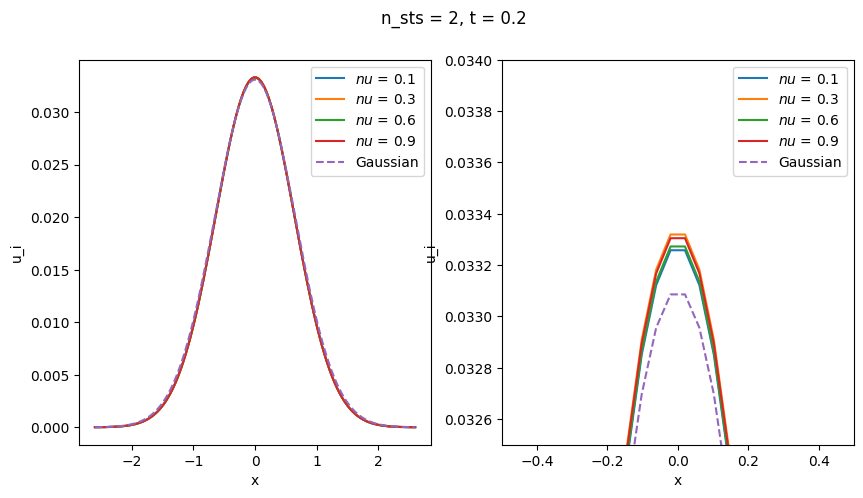

In [41]:
nu_list = np.array([0.1, 0.3, 0.6 , 0.9])
n_sts_list = np.array([2, 10, 20, 50])
tt = 0.2

fig, axes = plt.subplots(1,2, figsize=(10, 5))

plt.suptitle(f"n_sts = {n_sts_list[0]}, t = {tt}")


for i in range(len(nu_list)): 
    t_sts, un_sts = nm.evol_sts(x, u0, nt , 1 , ddx = deriv2, bnd_limits=[1,1], nu=nu_list[i], n_sts=n_sts_list[0])

    time = np.argmin(np.abs(t_sts - tt))
    axes[0].plot(x, un_sts[:,time], label=fr"$nu$ = {nu_list[i]}")#, t = {t_sts[time]:.2f}")
    axes[1].plot(x, un_sts[:,time], label=fr"$nu$ = {nu_list[i]}")#, t = {t_sts[time]:.2f}")
    
axes[0].plot(x, Gaussian(x, max_A_t1*0.2**(-1/2), 0 , c_sig*0.2**0.5, 0),"--" ,label="Gaussian")
axes[1].plot(x, Gaussian(x, max_A_t1*0.2**(-1/2), 0 , c_sig*0.2**0.5, 0),"--" ,label="Gaussian")

axes[0].legend()
axes[1].legend()
axes[0].set_xlabel("x")
axes[0].set_ylabel("u_i")
axes[1].set_xlabel("x")
axes[1].set_ylabel("u_i")
axes[1].set_ylim(0.0325,0.034)
axes[1].set_xlim(-0.5,0.5)
plt.show()

In [42]:
plt.close()

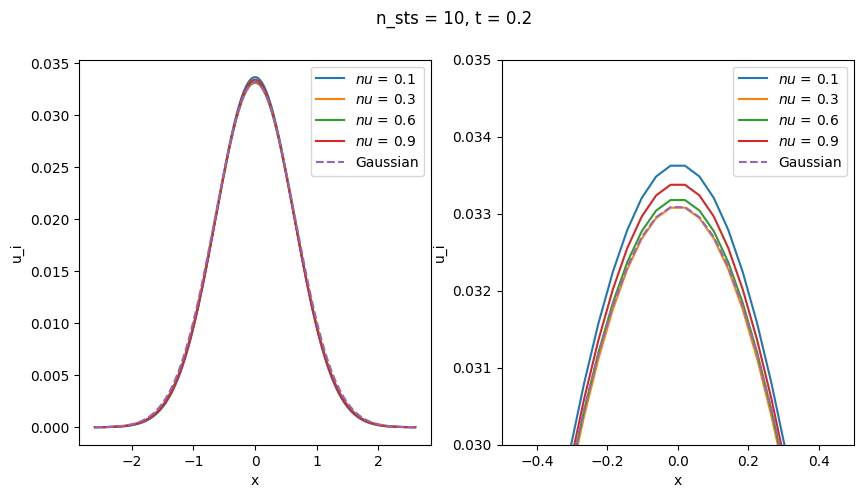

In [43]:
fig, axes = plt.subplots(1,2, figsize=(10, 5))
tt = 0.2

plt.suptitle(f"n_sts = {n_sts_list[1]}, t = {tt}")

for i in range(len(nu_list)): 
    t_sts, un_sts = nm.evol_sts(x, u0, nt , 1 , ddx = deriv2, bnd_limits=[1,1], nu=nu_list[i], n_sts=n_sts_list[1])

    time = np.argmin(np.abs(t_sts - tt))
    axes[0].plot(x, un_sts[:,time], label=fr"$nu$ = {nu_list[i]}")#, t = {t_sts[time]:.2f}")
    axes[1].plot(x, un_sts[:,time], label=fr"$nu$ = {nu_list[i]}")#, t = {t_sts[time]:.2f}")
    
axes[0].plot(x, Gaussian(x, max_A_t1*0.2**(-1/2), 0 , c_sig*0.2**0.5, 0),"--" ,label="Gaussian")
axes[1].plot(x, Gaussian(x, max_A_t1*0.2**(-1/2), 0 , c_sig*0.2**0.5, 0),"--" ,label="Gaussian")

axes[0].legend()
axes[1].legend()
axes[0].set_xlabel("x")
axes[0].set_ylabel("u_i")
axes[1].set_xlabel("x")
axes[1].set_ylabel("u_i")
axes[1].set_ylim(0.03,0.035)
axes[1].set_xlim(-0.5,0.5)
plt.show()

In [44]:
plt.close()

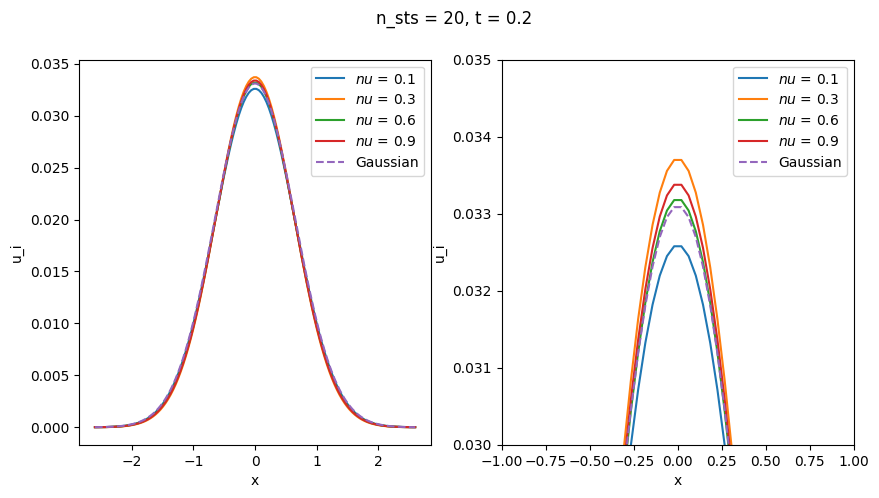

In [45]:
fig, axes = plt.subplots(1,2, figsize=(10, 5))
tt = 0.2
plt.suptitle(f"n_sts = {n_sts_list[2]}, t = {tt}")

for i in range(len(nu_list)): 
    t_sts, un_sts = nm.evol_sts(x, u0, nt , 1 , ddx = deriv2, bnd_limits=[1,1], nu=nu_list[i], n_sts=n_sts_list[2])

    time = np.argmin(np.abs(t_sts - tt))
    axes[0].plot(x, un_sts[:,time], label=fr"$nu$ = {nu_list[i]}")
    axes[1].plot(x, un_sts[:,time], label=fr"$nu$ = {nu_list[i]}")

    
axes[0].plot(x, Gaussian(x, max_A_t1*0.2**(-1/2), 0 , c_sig*0.2**0.5, 0),"--" ,label="Gaussian")
axes[1].plot(x, Gaussian(x, max_A_t1*0.2**(-1/2), 0 , c_sig*0.2**0.5, 0),"--" ,label="Gaussian")

axes[0].legend()
axes[1].legend()
axes[0].set_xlabel("x")
axes[0].set_ylabel("u_i")
axes[1].set_xlabel("x")
axes[1].set_ylabel("u_i")
axes[1].set_ylim(0.03,0.035)
axes[1].set_xlim(-1,1)
plt.show()

In [46]:
plt.close()

In the three subplots above, we plot the solutions for four different values of $\nu \in (0,1)$, keeping the value of `niter` constant. In the plots we have used the analytical solution with the proportionalities from the wiki for comparison.

For the smallest value, of `niter` = 2, we see that the solutions lie closer together, but they are not close to the analytical solution.

Increasing the `niter` to 10 we see all the solution being very close to the analytical solution. From the zoomed in plot it appears that the solutions with $\nu = 0.1$ and $\nu = 0.6$ fit the analytical solution best. 

By increasing `niter` again, we still see that $\nu = 0.3$ gives us the solution that is closest to the analytical curve. The smallest $\nu$ however, is now the solution furthest away from the analytical one, in contrast to the previous plot.

From the plots, there does not seem to be one coherent relation between the $\nu$ and `niter` that gives us a better solution. This might indicate that there is something wrong with either our analytical solution, numerical solution or perhaps both. From the plots it appears to be a combination of $\nu$ and `niter` that gives us the best solution. In our case, `niter = 10` seem to be the best option for all our solutions, meaning it should not be too small nor too large. 

In the plots below we plot the error: 

$$
(data - analytical)/analytical,
$$

by first changing $\nu$ and then `niter`. 

In [47]:
nu_list = np.linspace(0.1, 1, 10)
n_sts_list = np.array([1, 5, 10, 20, 50])
error = np.zeros((len(nu_list)))

for i in range(len(nu_list)):

    t_sts, un_sts = nm.evol_sts(x, u0, nt , 1 , ddx = deriv2, bnd_limits=[1,1], nu=nu_list[i], n_sts=n_sts_list[2])
    time = np.argmin(np.abs(t_sts - tt))
    error[i] = np.abs(np.max(un_sts[:,time]) - np.max(Gaussian(x, max_A_t1*0.2**(-1/2), 0 , c_sig*0.2**0.5, 0)))/np.max(Gaussian(x, max_A_t1*0.2**(-1/2), 0 , c_sig*0.2**0.5, 0))
    

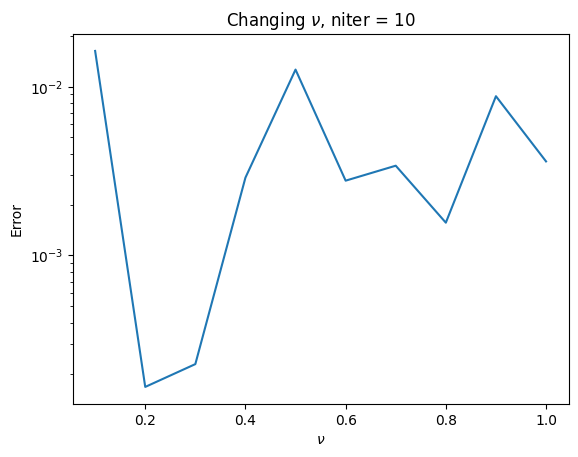

In [48]:


plt.plot(nu_list, error)
plt.yscale("log")
plt.xlabel(r"$\nu$")
plt.ylabel("Error")
plt.title(r"Changing $\nu$, niter = 10" )
plt.show()

In [49]:
plt.close()

As we saw in the `niter` = 10 plot, the $\nu = 0.6$ seems to be give us the best solution. This is also visible in the error plot above, with $\nu = 0.6$ having the lowest error. 

In [50]:

n_sts_list = np.arange(1,20)
error_nsts = np.zeros((len(n_sts_list)))

for i in range(len(n_sts_list)):

    t_sts, un_sts = nm.evol_sts(x, u0, nt , 1 , ddx = deriv2, bnd_limits=[1,1], nu=0.3, n_sts=10)
    time = np.argmin(np.abs(t_sts - tt))
    error_nsts[i] = np.abs(np.max(un_sts[:,time]) - np.max(Gaussian(x, max_A_t1*0.2**(-1/2), 0 , c_sig*0.2**0.5, 0)))/np.max(Gaussian(x, max_A_t1*0.2**(-1/2), 0 , c_sig*0.2**0.5, 0))


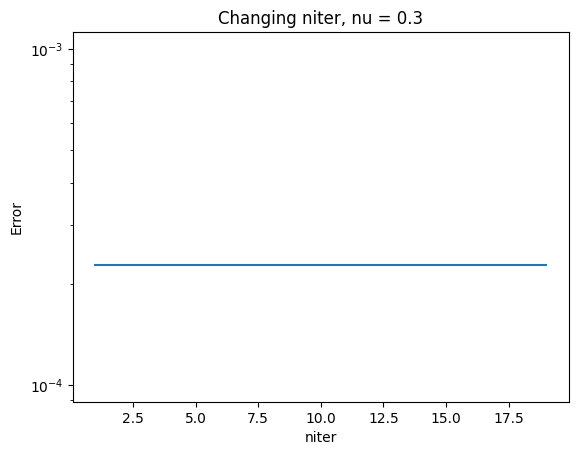

In [51]:
plt.plot(n_sts_list, error_nsts)
plt.yscale("log")
plt.xlabel("niter")
plt.ylabel("Error")
plt.title(r"Changing niter, nu = 0.3")
plt.show()

In [52]:
plt.close()

While the error plots show a rapidly changing error, it does fit with our results from the subplots earlier; they did not show a clear pattern of how the $\nu$ and `niter` could improve the solutions, and the results seem to change from plot to plot. The error curves do not seem to have a very clear pattern either, which is expected from the results we got. 

Looking at the error when changing `niter`, we see the lowest error when `niter` $\approx 9$, which makes sense since `niter` = 10 was the best value among the ones we tested. 

<span style="color:green"> JMS  </span>.

<span style="color:blue"> Great job! To clarify, the STS method has a roundoff error that gets bigger with large niter. So there is a clear limitation on how big niter can be (and how small nu can go). Idealy, one would like to have large niter and very lo nu because then the timestep will be much much larger. Let me know if you can understand this.</span>.
